### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
from chart_studio import plotly
import plotly.figure_factory as ff

In [5]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

In [6]:
DATA_VERSION = 'v4'

In [32]:
fig_dir = '../' + DATA_VERSION + '-fig/fig-correlations-no-eu/SCCS/'

In [8]:
gov_arch_csv = '../data/' + DATA_VERSION + '/communities_data_prepped.csv'

In [9]:
gov_df = pd.read_csv(gov_arch_csv)

In [10]:
# SCCS only
gov_df = gov_df.loc[gov_df['is_SCCS'] == 1]

In [11]:
gov_df.head()

,Name,Institutions,Mechanism,Notes,Time span,Geography,Size,Source,Metanotes,Heterogeneity,FC comments,expert check,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocra

In [12]:
# Drop Region: Europe

In [13]:
gov_df['Region: Europe'].sum()

0

In [14]:
gov_df = gov_df[gov_df['Region: Europe'] != 1]

In [15]:
gov_df['Region: Europe'].sum()

0

# Normalized Correlation Matrix

In [16]:
data_plot = gov_df.select_dtypes(include=[np.number]).dropna()

In [17]:
data_plot.describe()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_popularity_,access_mechanisms_include_payment_for_occupying_office,decision

In [ ]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

## Sort all correlations 

In [ ]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [20]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [21]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_assembly_central                  Geography: Oceania, Kiribati                  1.0
decision_making_mechanisms_include_president_consul_chief_executive  Geography: North America, Alaska              1.0
Geography: Africa                                                    Region: Africa                                1.0
decision_making_mechanisms_include_delegation                        decision_making_mechanisms_include_consent    1.0
enforcement_mechanisms_include_reputational_risk                     Geography: South America, Brazil              1.0
                                                                                                                  ... 
Region: Middle East                                                  Region: North America                         NaN
                                                                     Region: Central America                       NaN
                                                

In [33]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/' + DATA_VERSION + '/SCCS/mechanisms_all_correlations_no_europe.csv')

In [34]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start                                        Time span: Duration                                                -0.998233
                                                        Time span: End                                                     -0.985831
                                                        access_mechanisms_include_divine_right                             -0.646869
decision_making_mechanisms_include_gathering            decision_making_mechanisms_include_autocratic_leader_chief_bound   -0.599521
decision_making_mechanisms_include_magistrate_official  Geography: Oceania, New Caledonia                                  -0.547033
                                                                                                                              ...   
Region: Middle East                                     Region: North America                                                    NaN
                                                        Region: Centr

In [35]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/' + DATA_VERSION + '/SCCS/mechanisms_negative_correlations.csv')

# Mechanisms

In [36]:
mechanisms_list = [x for x in gov_df.columns if 'mechanisms_' in x]
mechanisms_list.sort()
mechanisms_list

['access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_blood_relations',
 'access_mechanisms_include_child_participation',
 'access_mechanisms_include_co-optation',
 'access_mechanisms_include_divine_right',
 'access_mechanisms_include_dreaming',
 'access_mechanisms_include_election',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_female_participation',
 'access_mechanisms_include_gerontocracy',
 'access_mechanisms_include_heredity',
 'access_mechanisms_include_induction_rite_ceremony',
 'access_mechanisms_include_life_appointment',
 'access_mechanisms_include_lottery_random_selection',
 'access_mechanisms_include_matriarchy',
 'access_mechanisms_include_matrilineality',
 'access_mechanisms_include_meritocracy',
 'access_mechanisms_include_open_political_unit',
 'access_mechanisms_include_patronage_for_office',
 'access_mechanisms_include_payment_for_occupying_office',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_pro

In [37]:
access_mechanisms = [x for x in gov_df.columns if 'access_mechanisms_' in x]

In [38]:
decision_making_mechanisms = [x for x in gov_df.columns if 'decision_making_mechanisms_' in x]

In [39]:
enforcement_mechanisms = [x for x in gov_df.columns if 'enforcement_mechanisms_' in x]

In [40]:
# mechanisms_df = gov_df[['Name'] + mechanisms_list]
mechanisms_df = gov_df[mechanisms_list]

In [41]:
mechanisms_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_prop

In [ ]:
plt.figure(figsize=(40,40))
sns.heatmap(mechanisms_df.corr(),
            cmap='BrBG')

plt.tight_layout()
plt.savefig(fig_dir + 'mechanisms_correlations.png')
plt.show()

### Look at correlations for specific variables

In [ ]:
norm_corr['Time span: Duration'].sort_values(ascending=False)

Time span: Duration                                                                1.000000
Time span: End                                                                     0.994057
access_mechanisms_include_divine_right                                             0.607352
decision_making_mechanisms_include_representation                                  0.531518
decision_making_mechanisms_include_checks_and_balances                             0.514248
enforcement_mechanisms_include_mediation                                           0.502820
enforcement_mechanisms_include_arbitration                                         0.481282
Geography: Oceania, Kiribati                                                       0.373228
decision_making_mechanisms_include_assembly_central                                0.373228
decision_making_mechanisms_include_council_local                                   0.368213
enforcement_mechanisms_include_jury_judge                                       

In [45]:
norm_corr['Time span: Duration'].sort_values(ascending=True)

Time span: Start                                                                  -0.998233
access_mechanisms_include_heredity                                                -0.362925
access_mechanisms_include_female_participation                                    -0.340332
Geography: North America                                                          -0.334515
access_mechanisms_include_meritocracy                                             -0.333338
decision_making_mechanisms_include_kingchief-as-figurehead                        -0.272988
access_mechanisms_include_child_participation                                     -0.254926
Size: 100 - 1,000                                                                 -0.254926
access_mechanisms_include_popularity_                                             -0.254926
decision_making_mechanisms_include_unanimity                                      -0.231392
enforcement_mechanisms_include_police                                           

In [46]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa                                                                  1.000000
decision_making_mechanisms_include_consultation                                    0.670156
Size: Unknown                                                                      0.604959
is_SCCS                                                                            0.519949
access_mechanisms_include_divine_right                                             0.429034
decision_making_mechanisms_include_veto                                            0.403392
decision_making_mechanisms_include_council_central_                                0.400561
access_mechanisms_include_election                                                 0.394644
enforcement_mechanisms_include_litigation                                          0.364661
decision_making_mechanisms_include_representation                               

In [47]:
norm_corr[['Region: Africa', 'Region: Oceania']]

,Region: Africa,Region: Oceania
Time span: Start,-0.301409,0.005902
Time span: End,0.285713,-0.006585
is_SCCS,0.519949,-0.090368
decision_making_mechanisms_include_representation,0.300430,-0.132281
enforcement_mechanisms_include_police,-0.207728,0.048136
enforcement_mechanisms_include_fines,-0.097446,-0.097533
decision_making_mechanisms_include_coalition,NaN,NaN
decision_making_mechanisms_include_unanimity,-0.207716,-0.207901
decision_making_mechanisms_include_bureaucracy,NaN,NaN
enforcement_mechanisms_include_reputational_risk,-0.097446,-0.097533


In [48]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=True)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include

In [49]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=False)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include

In [50]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa                                                                  1.000000
decision_making_mechanisms_include_consultation                                    0.670156
Size: Unknown                                                                      0.604959
is_SCCS                                                                            0.519949
access_mechanisms_include_divine_right                                             0.429034
decision_making_mechanisms_include_veto                                            0.403392
decision_making_mechanisms_include_council_central_                                0.400561
access_mechanisms_include_election                                                 0.394644
enforcement_mechanisms_include_litigation                                          0.364661
decision_making_mechanisms_include_representation                               

In [51]:
norm_corr['decision_making_mechanisms_include_assembly_central'].sort_values(ascending=False)

Geography: Oceania, Kiribati                                                       1.000000
decision_making_mechanisms_include_assembly_central                                1.000000
decision_making_mechanisms_include_checks_and_balances                             0.713255
enforcement_mechanisms_include_jury_judge                                          0.568616
enforcement_mechanisms_include_arbitration                                         0.486607
enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator    0.440529
decision_making_mechanisms_include_gathering                                       0.437353
Region: Oceania                                                                    0.437004
Time span: End                                                                     0.379221
Time span: Duration                                                                0.373228
Size: 10,001 - 100,000                                                          

In [52]:
mechanisms_corr_df = norm_corr[mechanisms_list]

In [53]:
mechanisms_corr_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_child_participation,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_prop

In [54]:
query_mechanisms_df = mechanisms_corr_df.transpose()

In [55]:
query_mechanisms_df.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_representation,enforcement_mechanisms_include_police,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_petition,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_lobbying,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_gathering,access_mechanisms_include_female_participation,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,access_mechanisms_include_property_requirement,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_consensus,access_mechanisms_include_child_participation,enforcement_mechanisms_include_exit,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_secret_ballot,access_mechanisms_include_meritocracy,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_co-optation,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_consent,enforcement_mechanisms_include_negotiation,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_council_central_,access_mechanisms_include_screening_process,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_assembly_central,access_mechanisms_include_heredity,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_ratification_acclamation_only,access_mechanisms_include_election,access_mechanisms_include_matriarchy,access_mechanisms_include_gerontocracy,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_forced_labour,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_popularity_,access_mechanisms_include_payment_for_occupying_office,decision

## Time x Mechanism

In [56]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [57]:
time_mechanisms = query_mechanisms_df[time_span_cols]
time_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_age_boundaries,-0.138628,0.190649,0.157509
access_mechanisms_include_blood_relations,0.206295,-0.238006,-0.218200
access_mechanisms_include_child_participation,0.246377,-0.268246,-0.254926
access_mechanisms_include_co-optation,NaN,NaN,NaN
access_mechanisms_include_divine_right,-0.646869,0.529389,0.607352
access_mechanisms_include_dreaming,NaN,NaN,NaN
access_mechanisms_include_election,-0.040002,-0.028580,0.015835
access_mechanisms_include_enfranchisement,NaN,NaN,NaN
access_mechanisms_include_female_participation,0.330931,-0.354428,-0.340332
access_mechanisms_include_gerontocracy,0.168839,-0.116575,-0.150872


In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(time_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_mechanisms.png')
plt.show()

### Time x Mechanism: Access, Decision Making, Enforcement

In [59]:
time_access_mechanisms = time_mechanisms.loc[access_mechanisms]

In [60]:
time_access_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_open_political_unit,-0.062296,0.066221,0.063889
access_mechanisms_include_female_participation,0.330931,-0.354428,-0.340332
access_mechanisms_include_induction_rite_ceremony,0.050751,-0.024831,-0.041733
access_mechanisms_include_property_requirement,0.142926,-0.164895,-0.151174
access_mechanisms_include_lottery_random_selection,NaN,NaN,NaN
access_mechanisms_include_child_participation,0.246377,-0.268246,-0.254926
access_mechanisms_include_patronage_for_office,NaN,NaN,NaN
access_mechanisms_include_meritocracy,0.340600,-0.316975,-0.333338
access_mechanisms_include_co-optation,NaN,NaN,NaN
access_mechanisms_include_screening_process,NaN,NaN,NaN


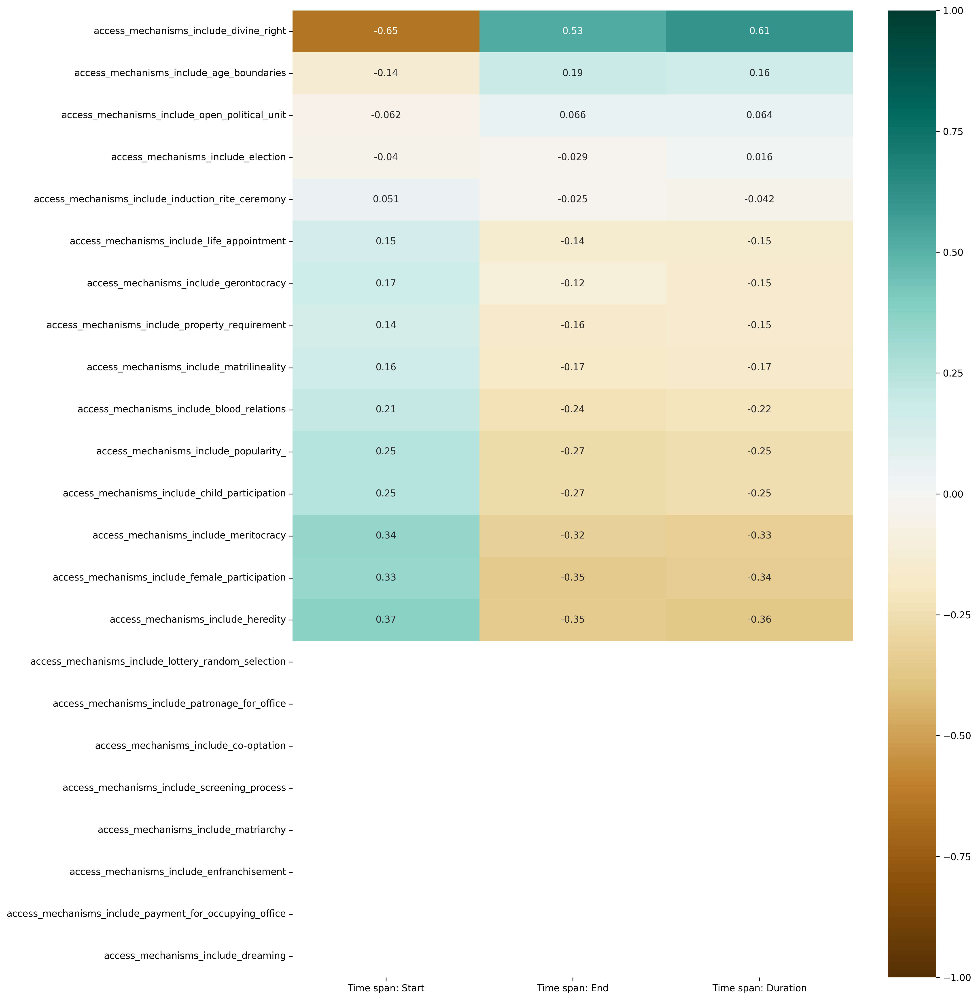

In [61]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_mechanisms.png')
plt.show()

In [62]:
time_decision_making_mechanisms = time_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_mechanisms.png')
plt.show()

In [ ]:
time_enforcement_mechanisms = time_mechanisms.loc[enforcement_mechanisms]

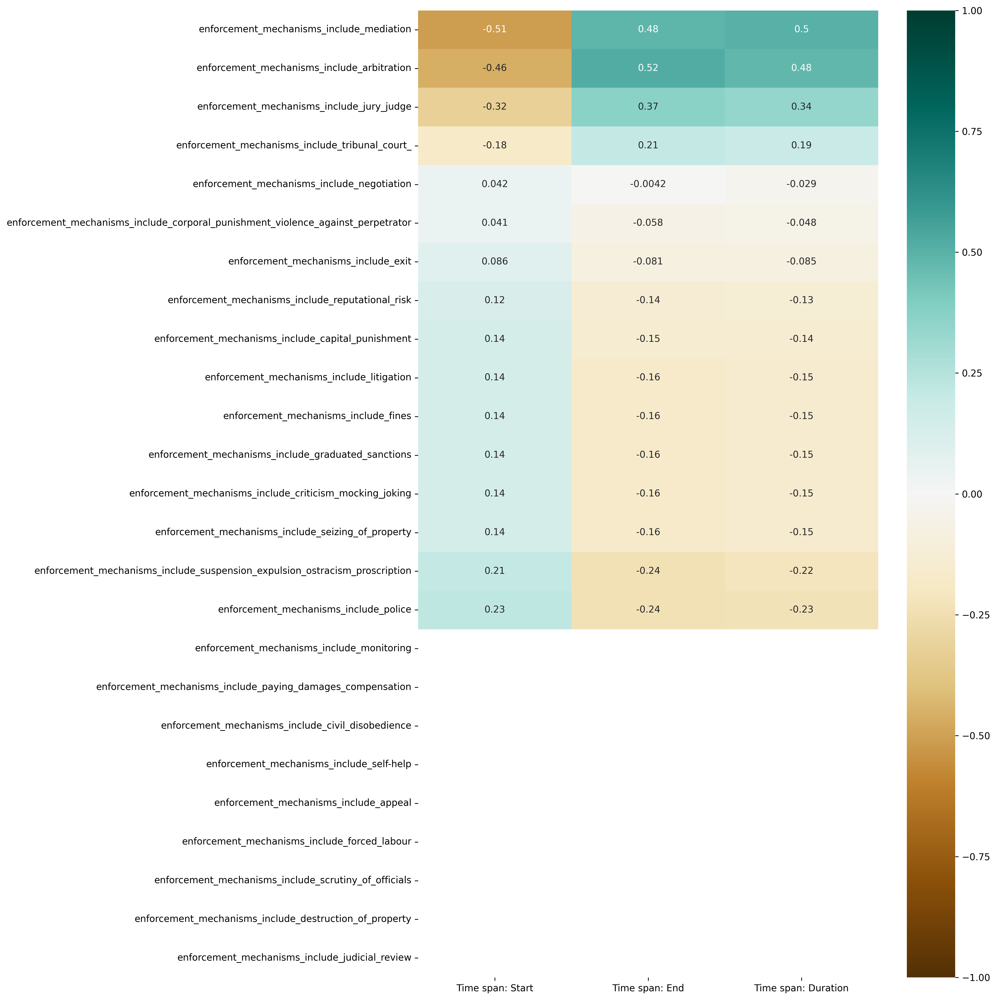

In [ ]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_enforcement_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_mechanisms.png')
plt.show()

# Region x Mechanism

In [66]:
region_cols = [r for r in list(gov_df) if 'Region: ' in r] 

In [67]:
region_cols

['Region: Africa',
 'Region: Europe',
 'Region: Asia',
 'Region: Middle East',
 'Region: North America',
 'Region: Central America',
 'Region: South America',
 'Region: Oceania']

In [68]:
region_mechanisms = query_mechanisms_df[region_cols]
region_mechanisms

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_mechanisms_include_age_boundaries,0.174401,NaN,-0.129973,NaN,-0.014085,-0.072029,0.188713,-0.175629
access_mechanisms_include_blood_relations,-0.140651,NaN,-0.104180,NaN,-0.210004,-0.057735,-0.103806,0.569875
access_mechanisms_include_child_participation,-0.207741,NaN,-0.153874,NaN,0.346845,-0.085275,-0.153321,0.065668
access_mechanisms_include_co-optation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
access_mechanisms_include_divine_right,0.429034,NaN,-0.072178,NaN,-0.145495,-0.040000,-0.071919,-0.097533
access_mechanisms_include_dreaming,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
access_mechanisms_include_election,0.394644,NaN,-0.218539,NaN,0.090677,0.307393,-0.217754,-0.295307
access_mechanisms_include_enfranchisement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
access_mechanisms_include_female_participation,-0.063935,NaN,-0.218929,NaN,0.087919,-0.121327,-0.218142,0.344749
access_mechanisms_include_gerontocracy,-0.089104,NaN,0.206618,NaN,0.211022,0.100480,-0.246079,-0.128107


In [69]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_mechanisms = region_mechanisms[cols_to_move + [col for col in region_mechanisms.columns if col not in cols_to_move]]

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_mechanisms.png')
plt.show()

### Region x Mechanism: Access, Decision Making, Enforcement

In [ ]:
region_access_mechanisms = region_mechanisms.loc[access_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_access_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_mechanisms.png')
plt.show()

In [73]:
region_decision_making_mechanisms = region_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_decision_making_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_mechanisms.png')
plt.show()

In [75]:
region_enforcement_mechanisms = region_mechanisms.loc[enforcement_mechanisms]

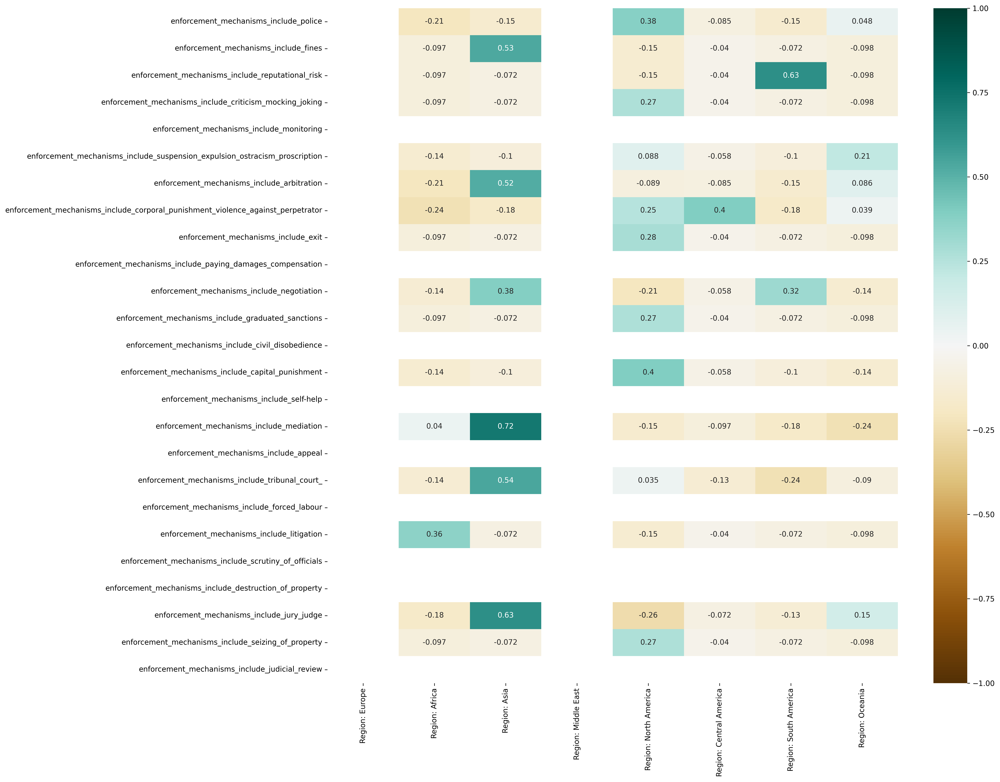

In [76]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_enforcement_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_mechanisms.png')
plt.show()

# Size x Mechanism

In [77]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [78]:
size_mechanisms = query_mechanisms_df[size_cols]

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(size_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_mechanisms.png')
plt.show()

### Size x Mechanism: Access, Decision Making, Enforcement

In [ ]:
size_access_mechanisms = size_mechanisms.loc[access_mechanisms]

In [81]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_access_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_mechanisms.png')
plt.show()

In [82]:
size_decision_making_mechanisms = size_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_decision_making_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_mechanisms.png')
plt.show()

In [84]:
size_enforcement_mechanisms = size_mechanisms.loc[enforcement_mechanisms]

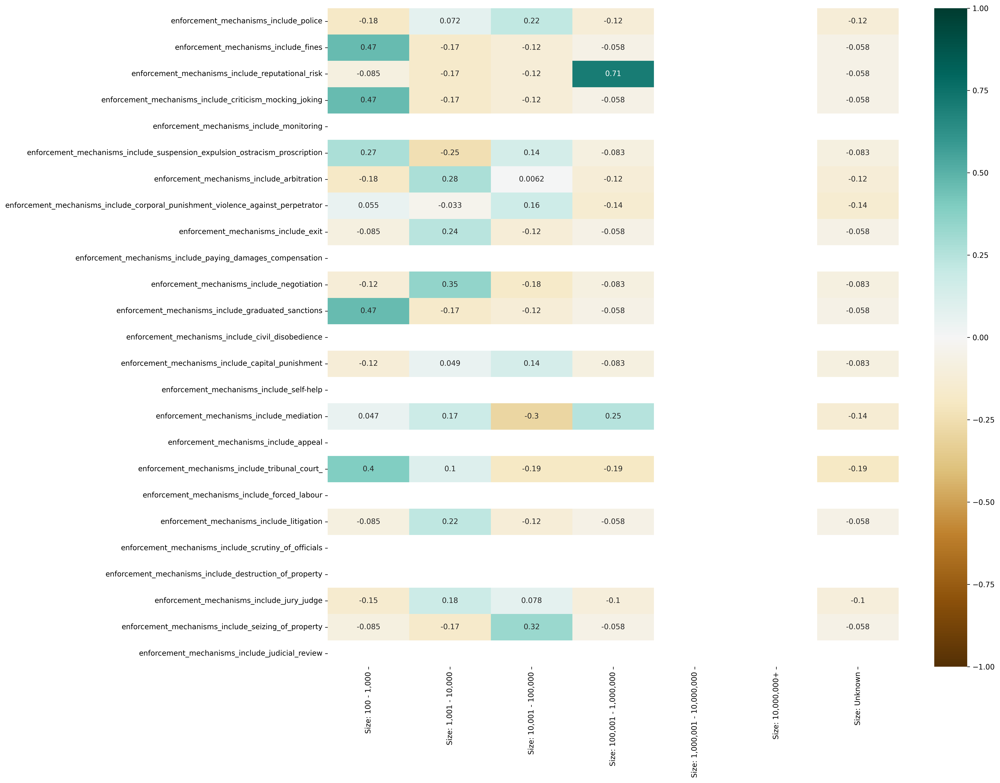

In [85]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_enforcement_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_mechanisms.png')
plt.show()

# Query and sort for mechanisms

In [86]:
def query_mech(col_name, ascending=False):
    # Return a sorted frame for a single column
    return query_mechanisms_df[col_name].sort_values(ascending=ascending)

In [87]:
query_mechanisms_df['Time span: Start'].sort_values(ascending=False)

access_mechanisms_include_heredity                                                 0.370683
access_mechanisms_include_meritocracy                                              0.340600
access_mechanisms_include_female_participation                                     0.330931
decision_making_mechanisms_include_kingchief-as-figurehead                         0.258093
access_mechanisms_include_popularity_                                              0.246379
access_mechanisms_include_child_participation                                      0.246377
decision_making_mechanisms_include_unanimity                                       0.226884
enforcement_mechanisms_include_police                                              0.225962
access_mechanisms_include_blood_relations                                          0.206295
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.206294
access_mechanisms_include_gerontocracy                                          

In [88]:
query_mech('Time span: Duration')

access_mechanisms_include_divine_right                                             0.607352
decision_making_mechanisms_include_representation                                  0.531518
decision_making_mechanisms_include_checks_and_balances                             0.514248
enforcement_mechanisms_include_mediation                                           0.502820
enforcement_mechanisms_include_arbitration                                         0.481282
decision_making_mechanisms_include_assembly_central                                0.373228
decision_making_mechanisms_include_council_local                                   0.368213
enforcement_mechanisms_include_jury_judge                                          0.341867
decision_making_mechanisms_include_delegation                                      0.338675
decision_making_mechanisms_include_consent                                         0.338675
decision_making_mechanisms_include_confederacy                                  

In [89]:
query_mech('Time span: Duration', ascending=True)

access_mechanisms_include_heredity                                                -0.362925
access_mechanisms_include_female_participation                                    -0.340332
access_mechanisms_include_meritocracy                                             -0.333338
decision_making_mechanisms_include_kingchief-as-figurehead                        -0.272988
access_mechanisms_include_child_participation                                     -0.254926
access_mechanisms_include_popularity_                                             -0.254926
decision_making_mechanisms_include_unanimity                                      -0.231392
enforcement_mechanisms_include_police                                             -0.230266
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription        -0.218201
access_mechanisms_include_blood_relations                                         -0.218200
access_mechanisms_include_matrilineality                                        

In [90]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Correlations: Community Mechanisms', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'mechanisms_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_68685/4156542858.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [91]:
plt.figure(figsize=(20,50))

heatmap = sns.heatmap(
    norm_corr[['Time span: Duration']].dropna().sort_values(
        by='Time span: Duration', 
        ascending=False), 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    annot_kws={"size": 8},
    xticklabels=1, 
    yticklabels=1, 
    cmap='BrBG')

heatmap.set_title('Features Correlating with Time span: Duration', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'duration_correlations.png')
plt.show()

# Time x Region x Size

In [92]:
norm_corr[time_span_cols + region_cols + size_cols]

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,-0.985831,-0.998233,-0.301409,NaN,-0.015298,NaN,0.222939,0.142925,-0.058768,0.005902,0.246378,0.028707,-0.033576,-0.364620,NaN,NaN,0.022000
Time span: End,-0.985831,1.000000,0.994057,0.285713,NaN,0.047690,NaN,-0.237953,-0.164897,0.081578,-0.006585,-0.268245,0.024879,0.024906,0.273133,NaN,NaN,0.021017
is_SCCS,-0.327773,0.326101,0.328247,0.519949,NaN,-0.055788,NaN,-0.323540,-0.151366,0.205247,-0.090368,-0.274445,-0.106231,-0.268238,0.666815,NaN,NaN,0.409506
decision_making_mechanisms_include_representation,-0.530563,0.528389,0.531518,0.300430,NaN,0.206651,NaN,-0.032222,-0.145291,-0.261229,-0.132281,0.111753,0.035509,-0.240687,0.109818,NaN,NaN,0.092079
enforcement_mechanisms_include_police,0.225962,-0.236037,-0.230266,-0.207728,NaN,-0.153865,NaN,0.378142,-0.085269,-0.153312,0.048136,-0.181783,0.071921,0.215608,-0.123040,NaN,NaN,-0.123016
enforcement_mechanisms_include_fines,0.142925,-0.164896,-0.151174,-0.097446,NaN,0.534326,NaN,-0.145495,-0.040000,-0.071919,-0.097533,0.465682,-0.171114,-0.121309,-0.057718,NaN,NaN,-0.057707
decision_making_mechanisms_include_coalition,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_mechanisms_include_unanimity,0.226884,-0.237526,-0.231392,-0.207716,NaN,-0.153855,NaN,0.587082,-0.085264,-0.153302,-0.207901,0.106687,0.074889,-0.026404,-0.123033,NaN,NaN,-0.123008
decision_making_mechanisms_include_bureaucracy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
enforcement_mechanisms_include_reputational_risk,0.123751,-0.135510,-0.128320,-0.097446,NaN,-0.072178,NaN,-0.145495,-0.040000,0.626960,-0.097533,-0.085275,-0.171114,-0.121309,0.709895,NaN,NaN,-0.057707


In [93]:
time_region_size = norm_corr[time_span_cols + region_cols + size_cols].loc[time_span_cols + region_cols + size_cols]

In [94]:
time_region_size

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,-0.985831,-0.998233,-0.301409,NaN,-0.015298,NaN,0.222939,0.142925,-0.058768,0.005902,0.246378,0.028707,-0.033576,-0.364620,NaN,NaN,0.022000
Time span: End,-0.985831,1.000000,0.994057,0.285713,NaN,0.047690,NaN,-0.237953,-0.164897,0.081578,-0.006585,-0.268245,0.024879,0.024906,0.273133,NaN,NaN,0.021017
Time span: Duration,-0.998233,0.994057,1.000000,0.296829,NaN,0.026824,NaN,-0.228983,-0.151174,0.067041,-0.006163,-0.254926,-0.009816,0.030613,0.333394,NaN,NaN,-0.006832
Region: Africa,-0.301409,0.285713,0.296829,1.000000,NaN,-0.175836,NaN,-0.354447,-0.097446,-0.175204,-0.237603,-0.207741,-0.029127,-0.295526,0.230490,NaN,NaN,0.604959
Region: Europe,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Region: Asia,-0.015298,0.047690,0.026824,-0.175836,NaN,1.000000,NaN,-0.262540,-0.072178,-0.129774,-0.175993,0.167431,0.192382,-0.218896,-0.104150,NaN,NaN,-0.104130
Region: Middle East,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Region: North America,0.222939,-0.237953,-0.228983,-0.354447,NaN,-0.262540,NaN,1.000000,-0.145495,-0.261596,-0.354764,0.357561,0.031172,-0.078787,-0.209944,NaN,NaN,-0.209902
Region: Central America,0.142925,-0.164897,-0.151174,-0.097446,NaN,-0.072178,NaN,-0.145495,1.000000,-0.071919,-0.097533,-0.085275,0.220299,-0.121309,-0.057718,NaN,NaN,-0.057707
Region: South America,-0.058768,0.081578,0.067041,-0.175204,NaN,-0.129774,NaN,-0.261596,-0.071919,1.000000,-0.175360,-0.153321,-0.076391,0.019231,0.412059,NaN,NaN,-0.103755


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_68685/18854544.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))


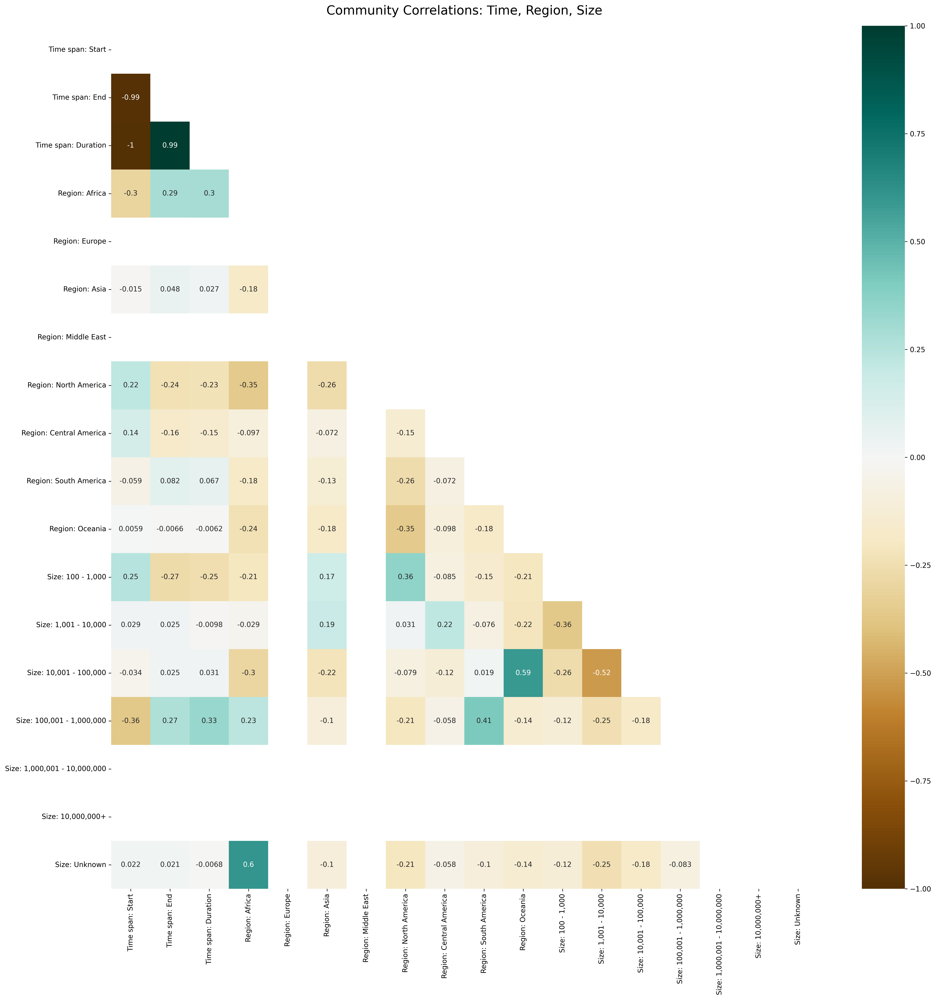

In [95]:
plt.figure(figsize=(20, 20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    time_region_size, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Community Correlations: Time, Region, Size', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'communities_time_region_size.png')
plt.show()

## Time

In [96]:
time_corr = norm_corr[time_span_cols].loc[region_cols + size_cols]

In [97]:
time_corr

,Time span: Start,Time span: End,Time span: Duration
Region: Africa,-0.301409,0.285713,0.296829
Region: Europe,NaN,NaN,NaN
Region: Asia,-0.015298,0.047690,0.026824
Region: Middle East,NaN,NaN,NaN
Region: North America,0.222939,-0.237953,-0.228983
Region: Central America,0.142925,-0.164897,-0.151174
Region: South America,-0.058768,0.081578,0.067041
Region: Oceania,0.005902,-0.006585,-0.006163
"Size: 100 - 1,000",0.246378,-0.268245,-0.254926
"Size: 1,001 - 10,000",0.028707,0.024879,-0.009816


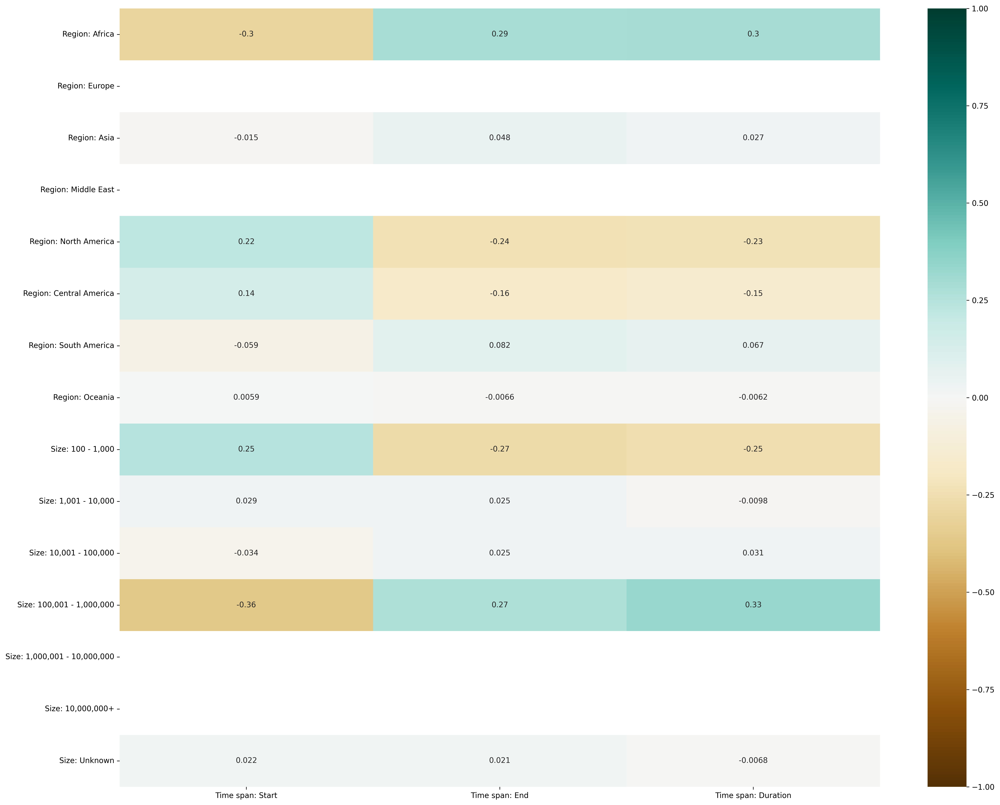

In [98]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'communities_time_correlations.png')
plt.show()

## Region

In [99]:
region_corr = norm_corr[region_cols].loc[time_span_cols + size_cols]

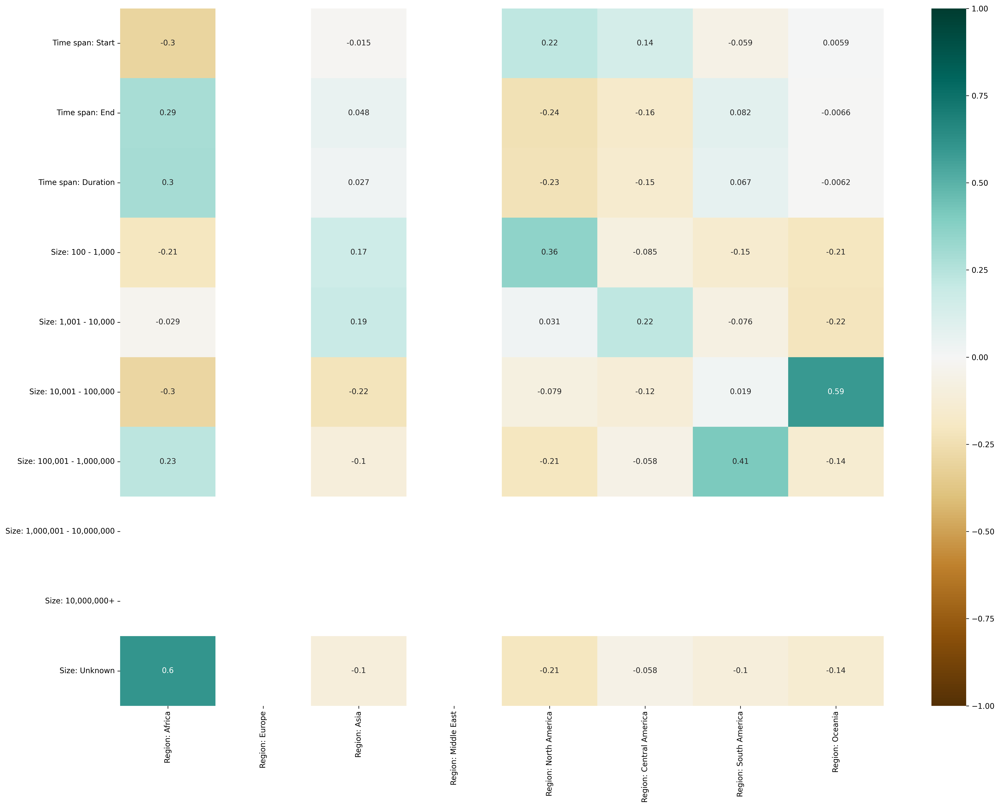

In [100]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'communities_region_correlations.png')
plt.show()

## Size 

In [101]:
size_corr = norm_corr[size_cols].loc[time_span_cols + region_cols]

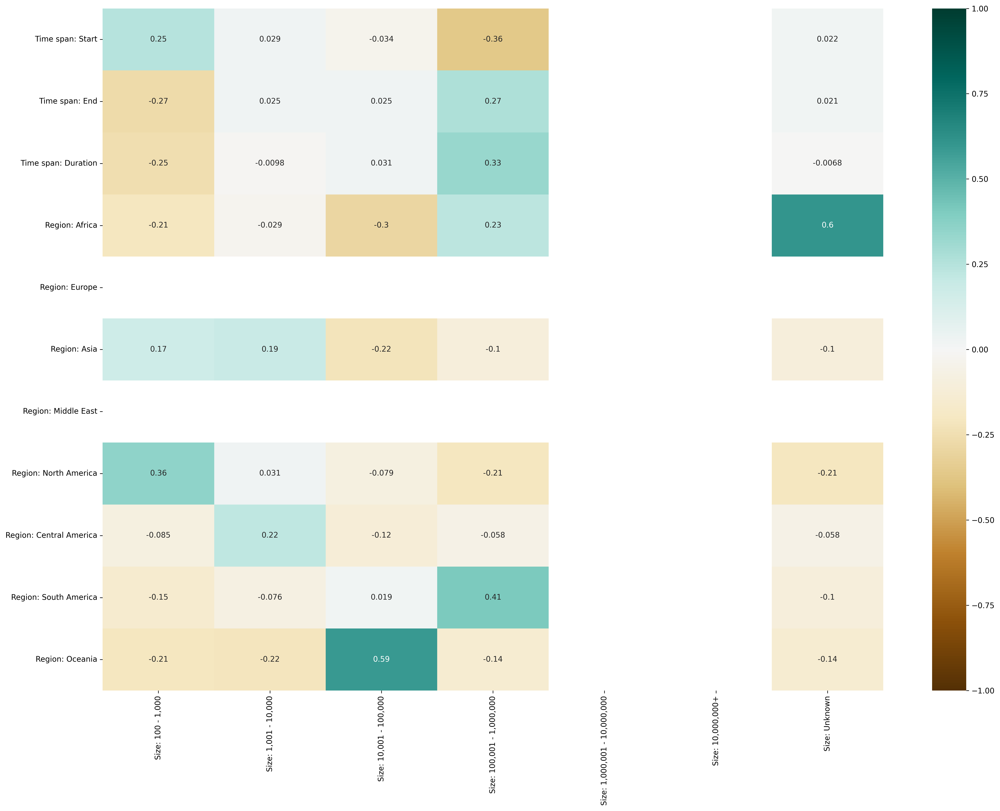

In [102]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'communities_size_correlations.png')
plt.show()